In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px

In [17]:
acc = pd.read_csv('sample data/ACCcopy.csv')
acc

,x,y,z
0,-18,8,42
1,-12,8,65
2,0,14,80
3,-6,16,68
4,0,-4,58
...,...,...,...
168349,-65,-7,3
168350,-65,-7,3
168351,-65,-7,3
168352,-65,-9,4


In [18]:
df = acc

df.isna().sum()

x    0
y    0
z    0
dtype: int64

In [19]:
print(df['x'].max(), df['x'].min())

127 -128


In [20]:
print(df['y'].max(), df['y'].min())

127 -128


In [21]:
print(df['z'].max(), df['z'].min())

127 -128


In [22]:
fig = px.scatter_3d(df, x='x', y='y', z='z')

# Define the new axis ranges for bettwe view
min_value = -200
max_value =  200
new_x_range = [min_value, max_value]  # Replace min_value and max_value
new_y_range = [min_value, max_value]
new_z_range = [min_value, max_value]

# Update the scene attributes to change the axis ranges
fig.update_scenes(xaxis_range=new_x_range, yaxis_range=new_y_range, zaxis_range=new_z_range)

fig.show()

In [23]:
temp = pd.read_csv('sample data/tempcopy.csv')
temp

,(unix timestamp in UTC) 1651166313
0,4.00
1,34.66
2,34.66
3,34.66
4,34.66
...,...
21052,33.23
21053,33.09
21054,33.09
21055,33.09


In [24]:
# to keep the Sample Rate the same for temp(4 HZ) and ACC(32Hz) to merge for visualize
temp_repeat = temp.loc[temp.index.repeat(8)].reset_index(drop=True)
temp_repeat

,(unix timestamp in UTC) 1651166313
0,4.00
1,4.00
2,4.00
3,4.00
4,4.00
...,...
168451,33.09
168452,33.09
168453,33.09
168454,33.09


In [25]:
merged = pd.concat([acc, temp_repeat], axis=1)
merged

,x,y,z,(unix timestamp in UTC) 1651166313
0,-18.0,8.0,42.0,4.00
1,-12.0,8.0,65.0,4.00
2,0.0,14.0,80.0,4.00
3,-6.0,16.0,68.0,4.00
4,0.0,-4.0,58.0,4.00
...,...,...,...,...
168451,NaN,NaN,NaN,33.09
168452,NaN,NaN,NaN,33.09
168453,NaN,NaN,NaN,33.09
168454,NaN,NaN,NaN,33.09


In [26]:
fig2 = px.scatter_3d(merged, x='x', y='y', z='z', color='(unix timestamp in UTC) 1651166313')

# Define the new axis ranges for bettwe view
min_value = -200
max_value =  200
new_x_range = [min_value, max_value]  # Replace min_value and max_value
new_y_range = [min_value, max_value]
new_z_range = [min_value, max_value]

# Update the scene attributes to change the axis ranges
fig2.update_scenes(xaxis_range=new_x_range, yaxis_range=new_y_range, zaxis_range=new_z_range)

fig2.show()

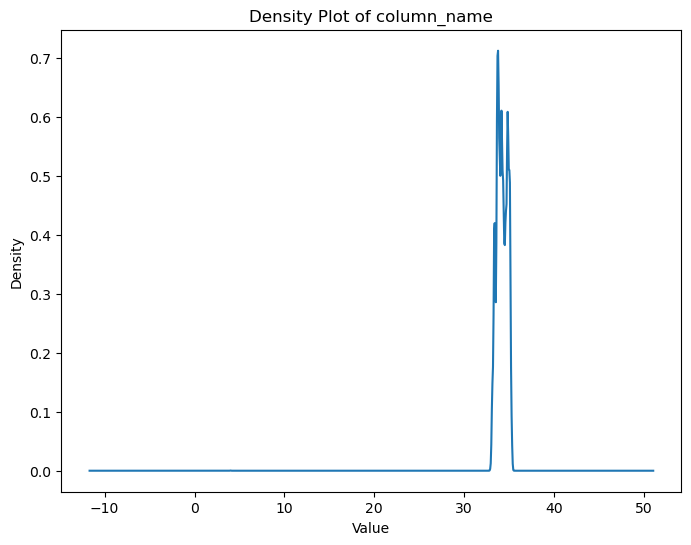

In [27]:
#most of temp is around 30 - 40
plt.figure(figsize=(8, 6))
merged['(unix timestamp in UTC) 1651166313'].plot(kind='density')
plt.xlabel('Value')
plt.ylabel('Density')
plt.title('Density Plot of column_name')
plt.show()

In [28]:
# lets dive into the temp range of 30-35 more
filtered = merged[merged['(unix timestamp in UTC) 1651166313']>=30]
filtered

,x,y,z,(unix timestamp in UTC) 1651166313
8,-1.0,-14.0,60.0,34.66
9,-3.0,8.0,65.0,34.66
10,-12.0,-6.0,54.0,34.66
11,5.0,7.0,65.0,34.66
12,2.0,-1.0,66.0,34.66
...,...,...,...,...
168451,NaN,NaN,NaN,33.09
168452,NaN,NaN,NaN,33.09
168453,NaN,NaN,NaN,33.09
168454,NaN,NaN,NaN,33.09


In [29]:
merged.shape[0] - filtered.shape[0]

8

In [30]:
fig3 = px.scatter_3d(filtered, x='x', y='y', z='z', color='(unix timestamp in UTC) 1651166313')

# Define the new axis ranges for bettwe view
min_value = -200
max_value =  200
new_x_range = [min_value, max_value]  # Replace min_value and max_value
new_y_range = [min_value, max_value]
new_z_range = [min_value, max_value]

# Update the scene attributes to change the axis ranges
fig3.update_scenes(xaxis_range=new_x_range, yaxis_range=new_y_range, zaxis_range=new_z_range)

fig3.show()